In [1]:
import scanpy as sc
import pandas as pd 
import numpy as np
import matplotlib.pyplot as pl
from matplotlib import rcParams
import os
from collections import Counter
os.chdir("/home/wyh/scdata/")

<frozen importlib._bootstrap>:228: RuntimeWarning: scipy._lib.messagestream.MessageStream size changed, may indicate binary incompatibility. Expected 56 from C header, got 64 from PyObject


In [27]:
sc.settings.set_figure_params(figsize=(3, 3))
sc.settings.set_figure_params(dpi=800, frameon=False, figsize=(3, 3), facecolor='white') 

# porcessing of original data

In [38]:
adata = sc.read("./combined_data/h5ad_file/combine_final0609.h5ad")

In [ ]:
sc.pp.filter_cells(adata, min_genes=200)
sc.pp.filter_genes(adata, min_cells=3)

sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

In [ ]:
cell_cycle_genes = pd.read_csv("./combined_data/cell_cycling_genes.csv",index_col=0)
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]

s_genes = [x for x in s_genes.iloc[:,0] if x in adata.var_names]
g2m_genes = [x for x in g2m_genes.iloc[:,0] if x in adata.var_names]

sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)

In [ ]:
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)
adata[:,adata.var.highly_variable].write("./combined_data/h5ad_file/combine_filter0609.h5ad")

# filtered data dimension reduction

In [38]:
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
#sc.logging.print_versions()
results_file = './combined_data/h5ad_file/combine_filter0609.h5ad'
adata = sc.read_h5ad(results_file)

In [4]:
sc.pp.regress_out(adata, ['nCount_RNA', 'nFeature_RNA',"S_score","G2M_score"])

regressing out ['nCount_RNA', 'nFeature_RNA', 'S_score', 'G2M_score']
    sparse input is densified and may lead to high memory use
    finished (1:15:12)


In [5]:
sc.pp.scale(adata, max_value=10)
sc.tl.pca(adata, svd_solver='arpack')
#sc.pl.pca(adata, color='CST3')
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=30)
sc.tl.umap(adata)
sc.tl.leiden(adata)

In [7]:
adata.write(results_file)

# add dimentional reduction data to the original data

In [95]:
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
#sc.logging.print_versions()
results_file = './combined_data/h5ad_file/combine_final0609.h5ad'
sc.settings.set_figure_params(dpi=300, frameon=False, figsize=(3, 3), facecolor='white') 

In [96]:
adata_original = sc.read_h5ad(results_file)

In [35]:
adata_original.obs['leiden'] = adata.obs['leiden'].astype("category")
adata_original.obsm['X_umap'] = adata.obsm['X_umap']

In [44]:
adata_original.write("./combined_data/h5ad_file/combine_final0609.h5ad")

## combine the clinical data

In [6]:
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
#sc.logging.print_versions()
results_file = './combined_data/h5ad_file/combine_final0609.h5ad'
adata_original = sc.read_h5ad(results_file)

In [9]:
# coimbine the clinical data
patient_info = pd.read_csv("/home/wyh/scdata/patient_info/xzh_220109_final_wyh_220426.csv",index_col=0)
adata_original.obs["NewSample.ID"] = adata_original.obs["orig.ident"]
adata_original.obs["barcodes"] = adata_original.obs_names

cols_to_use = patient_info.columns.difference(adata_original.obs.columns)
cols_to_use = list(cols_to_use)
cols_to_use.append("NewSample.ID")

meta_data = adata_original.obs.merge(patient_info.loc[:,cols_to_use], on='NewSample.ID', how='left')
meta_data.index = meta_data['barcodes']
adata_original.obs = meta_data

In [ ]:
adata_original.write("./combined_data/h5ad_file/combine_final0609.h5ad")

# figure in final paper

In [11]:
celltype = pd.read_csv("/home/wyh/scdata/combined_data/meta_data/celltype/celltype_combined0630.csv",index_col = 0)
np.unique(celltype['class'])

array(['B cells', 'CD4+ T cells', 'CD8+ T cells', 'Dendritic cells',
       'Endothelial cells', 'Epithelial cells', 'Fibroblasts',
       'Mast cells', 'Monocytes & Macrophages', 'NET', 'NK cells',
       'Neutrophils', 'Plasma cells'], dtype=object)

In [14]:
# fineture the celltypes
barcodes_38 = adata_original.obs_names[adata_original.obs['leiden']==38]
celltype.loc[barcodes_38,"class"] = "Epithelial cells"
celltype.loc[barcodes_38,"celltype"] = "Epithelial cells"


In [15]:
barcodes_29 = adata_original.obs_names[adata_original.obs['leiden']==29]
barcodes_29 = [ibarcode for ibarcode in barcodes_29 if(ibarcode in celltype.index)]
celltype.loc[barcodes_29,"class"] = "Epithelial cells"
celltype.loc[barcodes_29,"celltype"] = "Epithelial cells"

In [67]:
Myeloid_cell_Mast_SubMeta = pd.read_csv("/home/wyh/scdata/temp/Myeloid_cell_Mast_SubMeta.csv",index_col = 0)
barcodes_mast_delete = [icell for icell in Myeloid_cell_Mast_SubMeta['cell_id'] if(Myeloid_cell_Mast_SubMeta.loc[icell,'Cluster'] in [1,2,3])]
celltype.drop(barcodes_mast_delete,inplace = True)

In [17]:
celltype.to_csv("/home/wyh/scdata/combined_data/meta_data/celltype/celltype_combined0823V2.csv")

In [19]:
adata_original_new = adata_original[celltype.index,:]

In [20]:
adata_original_new.obs['Cell types'] = celltype.loc[:,'class']

/tmp/ipykernel_2745220/952757494.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_original_new.obs['Cell types'] = celltype.loc[:,'class']


In [21]:
adata_original_new.obs['Cell types'][adata_original_new.obs['Cell types']=="CD4+ T cells"] = "NK & T cells"
adata_original_new.obs['Cell types'][adata_original_new.obs['Cell types']=="CD8+ T cells"] = "NK & T cells"
adata_original_new.obs['Cell types'][adata_original_new.obs['Cell types']=="NK cells"] = "NK & T cells"

/tmp/ipykernel_2745220/3628268205.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_original_new.obs['Cell types'][adata_original_new.obs['Cell types']=="CD4+ T cells"] = "NK & T cells"
/tmp/ipykernel_2745220/3628268205.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_original_new.obs['Cell types'][adata_original_new.obs['Cell types']=="CD8+ T cells"] = "NK & T cells"
/tmp/ipykernel_2745220/3628268205.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

In [22]:
sc.pp.normalize_total(adata_original_new, target_sum=1e4)
sc.pp.log1p(adata_original_new)

normalizing counts per cell
    finished (0:00:06)


In [26]:
adata_original_new.write("./combined_data/h5ad_file/adata_original_0823_plot.h5ad")

In [27]:
adata_original_new

AnnData object with n_obs × n_vars = 1146638 × 32137
    obs: 'B.cells.corr', 'Cell.Type', 'CellCycle.score', 'Endothelial.corr', 'Epithelial.corr', 'Fibroblast.corr', 'GS__ADIPOGENESIS', 'GS__ALLOGRAFT_REJECTION', 'GS__ANDROGEN_RESPONSE', 'GS__ANGIOGENESIS', 'GS__APICAL_JUNCTION', 'GS__APICAL_SURFACE', 'GS__APOPTOSIS', 'GS__BILE_ACID_METABOLISM', 'GS__CHOLESTEROL_HOMEOSTASIS', 'GS__COAGULATION', 'GS__COMPLEMENT', 'GS__DNA_REPAIR', 'GS__E2F_TARGETS', 'GS__EPITHELIAL_MESENCHYMAL_TRANSITION', 'GS__ESTROGEN_RESPONSE_EARLY', 'GS__ESTROGEN_RESPONSE_LATE', 'GS__FATTY_ACID_METABOLISM', 'GS__G2M_CHECKPOINT', 'GS__GLYCOLYSIS', 'GS__HEDGEHOG_SIGNALING', 'GS__HEME_METABOLISM', 'GS__HYPOXIA', 'GS__IL2_STAT5_SIGNALING', 'GS__IL6_JAK_STAT3_SIGNALING', 'GS__INFLAMMATORY_RESPONSE', 'GS__INTERFERON_ALPHA_RESPONSE', 'GS__INTERFERON_GAMMA_RESPONSE', 'GS__KRAS_SIGNALING_DN', 'GS__KRAS_SIGNALING_UP', 'GS__MITOTIC_SPINDLE', 'GS__MTORC1_SIGNALING', 'GS__MYC_TARGETS_V1', 'GS__MYC_TARGETS_V2', 'GS__MYOGENESIS'

## celltype upload

In this section, We retain the cell type after quality control.

In [14]:
adata_original_new = sc.read_h5ad("./combined_data/h5ad_file/adata_original_0823_plot.h5ad")

In [18]:
celltype_info_all_filter_final = pd.read_csv("./combined_data/meta_data/celltype20230610/celltype_info_all_filter_final.csv",index_col = 0)

In [53]:
Counter(celltype_info_all_filter_final.loc[celltype_info_all_filter_final.index.difference(adata_original_new.obs_names),'celltype']) # the mast cells are delete in the first step

Counter({'Mast': 1687})

In [21]:
adata_original_new_final_filter = adata_original_new[np.intersect1d(adata_original_new.obs_names,celltype_info_all_filter_final.index),:].copy()

In [22]:
adata_original_new_final_filter

AnnData object with n_obs × n_vars = 1117245 × 32137
    obs: 'B.cells.corr', 'Cell.Type', 'CellCycle.score', 'Endothelial.corr', 'Epithelial.corr', 'Fibroblast.corr', 'GS__ADIPOGENESIS', 'GS__ALLOGRAFT_REJECTION', 'GS__ANDROGEN_RESPONSE', 'GS__ANGIOGENESIS', 'GS__APICAL_JUNCTION', 'GS__APICAL_SURFACE', 'GS__APOPTOSIS', 'GS__BILE_ACID_METABOLISM', 'GS__CHOLESTEROL_HOMEOSTASIS', 'GS__COAGULATION', 'GS__COMPLEMENT', 'GS__DNA_REPAIR', 'GS__E2F_TARGETS', 'GS__EPITHELIAL_MESENCHYMAL_TRANSITION', 'GS__ESTROGEN_RESPONSE_EARLY', 'GS__ESTROGEN_RESPONSE_LATE', 'GS__FATTY_ACID_METABOLISM', 'GS__G2M_CHECKPOINT', 'GS__GLYCOLYSIS', 'GS__HEDGEHOG_SIGNALING', 'GS__HEME_METABOLISM', 'GS__HYPOXIA', 'GS__IL2_STAT5_SIGNALING', 'GS__IL6_JAK_STAT3_SIGNALING', 'GS__INFLAMMATORY_RESPONSE', 'GS__INTERFERON_ALPHA_RESPONSE', 'GS__INTERFERON_GAMMA_RESPONSE', 'GS__KRAS_SIGNALING_DN', 'GS__KRAS_SIGNALING_UP', 'GS__MITOTIC_SPINDLE', 'GS__MTORC1_SIGNALING', 'GS__MYC_TARGETS_V1', 'GS__MYC_TARGETS_V2', 'GS__MYOGENESIS'

In [23]:
adata_original_new_final_filter.obs['subtype'] = None

In [24]:
adata_original_new_final_filter.obs.loc[:,'subtype'] = celltype_info_all_filter_final.loc[adata_original_new_final_filter.obs_names,'subtype']
adata_original_new_final_filter.obs.loc[:,'celltype'] = celltype_info_all_filter_final.loc[adata_original_new_final_filter.obs_names,'celltype']

In [14]:
Counter(adata_original_new_final_filter.obs['celltype'])

Counter({'CD8 T cell': 179763,
         'Mast': 28441,
         'NK cell': 28266,
         'Mono_Macro': 144893,
         'fibroblast': 78485,
         'CD4 T cell': 152448,
         'DC': 13571,
         'Endothelium': 16886,
         'normal': 18635,
         'Neu': 120380,
         'Plasma cell': 37237,
         'tumor': 239486,
         'B cell': 58754})

In [27]:
adata_original_new_final_filter.write("./combined_data/h5ad_file/adata_original_final_filter.h5ad")

In [8]:
adata_original_new_final_filter = sc.read_h5ad("./combined_data/h5ad_file/adata_original_final_filter.h5ad")

In [13]:
adata_original_new_final_filter

AnnData object with n_obs × n_vars = 1117245 × 32137
    obs: 'B.cells.corr', 'Cell.Type', 'CellCycle.score', 'Endothelial.corr', 'Epithelial.corr', 'Fibroblast.corr', 'GS__ADIPOGENESIS', 'GS__ALLOGRAFT_REJECTION', 'GS__ANDROGEN_RESPONSE', 'GS__ANGIOGENESIS', 'GS__APICAL_JUNCTION', 'GS__APICAL_SURFACE', 'GS__APOPTOSIS', 'GS__BILE_ACID_METABOLISM', 'GS__CHOLESTEROL_HOMEOSTASIS', 'GS__COAGULATION', 'GS__COMPLEMENT', 'GS__DNA_REPAIR', 'GS__E2F_TARGETS', 'GS__EPITHELIAL_MESENCHYMAL_TRANSITION', 'GS__ESTROGEN_RESPONSE_EARLY', 'GS__ESTROGEN_RESPONSE_LATE', 'GS__FATTY_ACID_METABOLISM', 'GS__G2M_CHECKPOINT', 'GS__GLYCOLYSIS', 'GS__HEDGEHOG_SIGNALING', 'GS__HEME_METABOLISM', 'GS__HYPOXIA', 'GS__IL2_STAT5_SIGNALING', 'GS__IL6_JAK_STAT3_SIGNALING', 'GS__INFLAMMATORY_RESPONSE', 'GS__INTERFERON_ALPHA_RESPONSE', 'GS__INTERFERON_GAMMA_RESPONSE', 'GS__KRAS_SIGNALING_DN', 'GS__KRAS_SIGNALING_UP', 'GS__MITOTIC_SPINDLE', 'GS__MTORC1_SIGNALING', 'GS__MYC_TARGETS_V1', 'GS__MYC_TARGETS_V2', 'GS__MYOGENESIS'

In [17]:
np.unique(adata_original_new_final_filter.obs['celltype'])

array(['B cell', 'CD4 T cell', 'CD8 T cell', 'DC', 'Endothelium', 'Mast',
       'Mono_Macro', 'NK cell', 'Neu', 'Plasma cell', 'fibroblast',
       'normal', 'tumor'], dtype=object)

In [45]:
replace_dict = {'B cell':"B cells",
                "CD4 T cell":"CD4+ T cells",
                 "CD8 T cell":"CD8+ T cell",
                "DC":"Dendritic cells",
                "Endothelium":"Endothelial cells",
                "Mast":"Mast cells",
                "Mono_Macro":"Monocytes & Macrophages",
                "NK cell":"NK cells",
                "Neu" : "Neutrophils",
                "Plasma cell" : "Plasma cells",
                "fibroblast" : "Mesenchymal cells",
                "normal" : "Epithelial cells",
                "tumor" : "Epithelial cells"}

In [46]:
celltype_lists =[replace_dict[i] if i in replace_dict else i for i in list(adata_original_new_final_filter.obs['celltype'])]

In [48]:
np.unique(celltype_lists)

array(['B cells', 'CD4+ T cells', 'CD8+ T cell', 'Dendritic cells',
       'Endothelial cells', 'Epithelial cells', 'Mast cells',
       'Mesenchymal cells', 'Monocytes & Macrophages', 'NK cells',
       'Neutrophils', 'Plasma cells'], dtype='<U23')

In [47]:
adata_original_new_final_filter.obs['celltype_unload'] =  celltype_lists

In [35]:
replace_dict = {'CD4T_C0_ANXA1':"CD4T_C0_ANXA1_TH1",
                "CD4T_C1_FOXP3":"CD4T_C1_FOXP3_TREG",
                 "CD4T_C2_CCR7":"CD4T_C2_CCR7_TN",
                "CD4T_C3_CXCL13":"CD4T_C3_CXCL13_TFH",
                "CD8T_C0_CCR7_GZMK":"CD8T_C0_CCR7_GZMK_TCM",
                "CD8T_C1_CXCL13":"CD8T_C1_CXCL13_TEX",
                "CD8T_C3_KLRC1":"CD8T_C3_KLRC1_TRM",
                "CD8T_C6_LTB":"CD8T_C6_LTB_MAIT",
                "CD8T_C12_TRDC" : "CD8T_C12_TRDC_γδT",
                "DC_C0_cDC2_IL1B" : "DC_C0_IL1B_cDC2",
                "DC_C1_cDC2_others" : "DC_C1_others_cDC2",
                "DC_C2_cDC3_FSCN1":"DC_C2_FSCN1",
                "DC_C3_cDC2_FCGBP":"DC_C3_FCGBP",
                "DC_C4_cDC2_PPP1R14A":"DC_C4_PPP1R14A_cDC2",
                "DC_C5_cDC1":"DC_C5_CLEC9A_cDC1",
                "DC_C6_pDC":"DC_C6_GZMB_pDC",
                "DC_C7_cDC3_ACY3":"DC_C7_ACY3",
                "N_C0_N0":"N_C0_MNDA",
                "N_C1_N2":"N_C1_ISG15",
               "N_C2_N1":"N_C2_CCL3L1",
               "N_C3_N1":"N_C3_CTSD",
               "N_C4_N1":"N_C4_CD44",
                "N_C5_N4":"N_C5_DEFA5",
                "N_C6_N2":"N_C6_ISG15_IFIT1",
               "N_C7_N0": "N_C7_MNDA_S100A8",
               "N_C8_N3" :"N_C8_IL1R2",
               "N_C9_Nc": "N_C9_S100A10",
               "N_C10_N0": "N_C10_STXBP2",
               "N_C11_N3": "N_C11_MGP",
                "EC_C0_ACKR1":"EC_C0_ACKR1_Vein",
                "EC_C1_KDR":"EC_C1_CD320_Capillary",
                "EC_C2_CXCR4":"EC_C2_CXCR4_Tip",
                "EC_C3_GJA5":"EC_C3_GJA5_Artery",
                "EC_C5_PROX1":"EC_C5_PROX1_Lymphatic",
                "normal":"Normal epithelial cells",
                "tumor":"Malignant epithelial cells",
               }

In [36]:
new_lists_subtype =[replace_dict[i] if i in replace_dict else i for i in list(adata_original_new_final_filter.obs['subtype'])]

In [38]:
adata_original_new_final_filter.obs['subtype_unload'] =  new_lists_subtype

In [62]:
celltype_upload = pd.DataFrame(adata_original_new_final_filter.obsm['X_umap'])
celltype_upload.columns = ['X',"Y"]

In [63]:
celltype_upload['celltype'] = celltype_lists
celltype_upload['subtype'] = new_lists_subtype
celltype_upload['name'] = adata_original_new_final_filter.obs_names
celltype_upload.index = adata_original_new_final_filter.obs_names

In [76]:
celltype_upload = celltype_upload.loc[:,["name",'X',"Y","celltype",'subtype']]

In [82]:
celltype_upload.to_csv("./combined_data/meta_data/celltype_upload.txt",sep='\t',index=False)

In [88]:
pd.DataFrame(adata_original_new_final_filter.obs['subtype']).to_csv("./combined_data/meta_data/adata_original_new_final_filter_subtype_original.csv")

### Find markers of each subtype that are significantly up-regulated 

In [4]:
adata_original_new_final_filter = sc.read_h5ad("./combined_data/h5ad_file/adata_original_final_filter.h5ad")
adata_original_new_final_filter.uns['log1p']['base'] = None

In [5]:
adata_original_new_final_filter

AnnData object with n_obs × n_vars = 1117245 × 32137
    obs: 'B.cells.corr', 'Cell.Type', 'CellCycle.score', 'Endothelial.corr', 'Epithelial.corr', 'Fibroblast.corr', 'GS__ADIPOGENESIS', 'GS__ALLOGRAFT_REJECTION', 'GS__ANDROGEN_RESPONSE', 'GS__ANGIOGENESIS', 'GS__APICAL_JUNCTION', 'GS__APICAL_SURFACE', 'GS__APOPTOSIS', 'GS__BILE_ACID_METABOLISM', 'GS__CHOLESTEROL_HOMEOSTASIS', 'GS__COAGULATION', 'GS__COMPLEMENT', 'GS__DNA_REPAIR', 'GS__E2F_TARGETS', 'GS__EPITHELIAL_MESENCHYMAL_TRANSITION', 'GS__ESTROGEN_RESPONSE_EARLY', 'GS__ESTROGEN_RESPONSE_LATE', 'GS__FATTY_ACID_METABOLISM', 'GS__G2M_CHECKPOINT', 'GS__GLYCOLYSIS', 'GS__HEDGEHOG_SIGNALING', 'GS__HEME_METABOLISM', 'GS__HYPOXIA', 'GS__IL2_STAT5_SIGNALING', 'GS__IL6_JAK_STAT3_SIGNALING', 'GS__INFLAMMATORY_RESPONSE', 'GS__INTERFERON_ALPHA_RESPONSE', 'GS__INTERFERON_GAMMA_RESPONSE', 'GS__KRAS_SIGNALING_DN', 'GS__KRAS_SIGNALING_UP', 'GS__MITOTIC_SPINDLE', 'GS__MTORC1_SIGNALING', 'GS__MYC_TARGETS_V1', 'GS__MYC_TARGETS_V2', 'GS__MYOGENESIS'

In [34]:
for itype in ["N_C0_N0", "N_C1_N2", "N_C2_N1", "N_C7_N0", "EC_C0_ACKR1", "EC_C5_PROX1",
              'F_C1_CFD','Per_C1_MYH11','Per_C3_STEAP4']:
    sc.tl.rank_genes_groups(adata_original_new_final_filter, groupby = 'subtype', method='wilcoxon',groups=[itype]) 
    result = adata_original_new_final_filter.uns['rank_genes_groups']
    groups = result['names'].dtype.names
    markers = pd.DataFrame(
        {group + '_' + key[:1]: result[key][group]
        for group in groups for key in ['names', 'pvals']})

    markers.to_csv("./combined_data/meta_data/"+itype+"_markers.csv")

### Find differentially expressed genes of each subtype based on downsampled data

In [16]:
# downsample by group
def get_class_num(df,n):
    def get_num(x):
        if(len(x)>n):
            sampled_x = x.sample(n).reset_index(drop=True)
        else:
            sampled_x = x
        return(sampled_x)
            
    weighted_sample = df.groupby('subtype').apply(get_num)  
    return(weighted_sample) 

            
df = adata_original_new_final_filter.obs
df['barcode'] = df.index
weighted_sample = get_class_num(df,2000)

In [22]:
adata_original_new_sample = adata_original_new_final_filter[weighted_sample['barcode'],].copy()

In [24]:
adata_original_new_sample.write("./adata_subtype_DE_sample.h5ad")

In [4]:
adata_original_new_sample = sc.read_h5ad("./adata_subtype_DE_sample.h5ad")
adata_original_new_sample.uns['log1p']['base'] = None

In [7]:
pd.DataFrame(adata_original_new_sample.obs_names).to_csv("./adata_subtype_DE_sample.barcodes.csv")

In [41]:
for isubtype in np.unique(adata_original_new_sample.obs['subtype']):
    sc.tl.rank_genes_groups(adata_original_new_sample, 'subtype',groups=[isubtype],pts=True,method='wilcoxon')
    DE_df = sc.get.rank_genes_groups_df(adata_original_new_sample, group=isubtype)
    DE_df.to_csv("/home/wyh/scdata/combined_data/subtype_DE/"+isubtype+"_DE.csv")

## All celltype UMAP

In [29]:
import matplotlib as mpl
import pandas as pd

In [4]:
adata_original_new = sc.read_h5ad("./combined_data/h5ad_file/adata_original_0823_plot.h5ad")

In [30]:
prop_cycle = mpl.rcParams["axes.prop_cycle"]
prop_cycle = pd.DataFrame(prop_cycle)

In [32]:
palette_celltype={}
color = ["#51574a" ,"#447c69" , "#74c493","#8e8c6d" , "#e4bf80" ,  "#e9d78e","#e2975d"  , "#f19670"  ,"#e16552","#c94a53" ,  "#be5168"  , "#a34974", "#993767", "#65387d"]
color = prop_cycle.iloc[range(len(np.unique(adata_original_new.obs['Cell types']))),:] 
i=0
for itype in np.unique(adata_original_new.obs['Cell types']):
    palette_celltype[itype] = color.iloc[i,0]
    i = i+1

In [112]:
palette_celltype

{'B cells': '#1f77b4',
 'Dendritic cells': '#ff7f0e',
 'Endothelial cells': '#279e68',
 'Epithelial cells': '#d62728',
 'Fibroblasts': '#aa40fc',
 'Mast cells': '#8c564b',
 'Monocytes & Macrophages': '#e377c2',
 'NET': '#b5bd61',
 'NK & T cells': '#17becf',
 'Neutrophils': '#aec7e8',
 'Plasma cells': '#ffbb78'}

In [ ]:
palette_celltype_output = pd.DataFrame(palette_celltype, index=[0])

In [26]:
palette_celltype_output.to_csv("./combined_data/figures/palette_celltype_output.csv")

In [ ]:
sc.pl.umap(adata_original_new,color = "Cell types",legend_loc = "on data",legend_fontsize=3,palette = palette_celltype)

In [ ]:
sc.settings.set_figure_params(dpi=1000, frameon=False, figsize=(5, 5), facecolor='white') 
sc.pl.umap(adata_original_new,color = "Cell types",legend_fontsize=5,palette = palette_celltype,save="celltype_dpi1000.pdf")

In [ ]:
sc.pl.umap(adata_original_new,color = ["Polyps"],legend_fontsize=5,save="Polyps.pdf",
           title=['Polyps'])

In [ ]:
sc.pl.umap(adata_original_new,color = ["Gallstones"],legend_fontsize=5,save="Gallstones.pdf",
           title=['Gallstones'])

In [30]:
color135 = pd.read_csv("./combined_data/database/color/color200.csv",index_col = 0).iloc[range(135),]

In [ ]:
sc.pl.umap(adata_original_new,color = ["NewSample.ID"],legend_fontsize=5,save="NewSample.pdf",
           title=['NewSample.ID'],palette  = list(color200['x']))

In [ ]:
sc.pl.umap(adata_original_new,color = ["histological.type.short"],legend_fontsize=5,save="histological.type.short.pdf",
           title=['Histological.type'])

In [ ]:
adata_original_new_plot = adata_original_new[adata_original_new.obs['histological.type.short']=="adeno",]
sc.pl.umap(adata_original_new[adata_original_new.obs['histological.type.short']=="adeno",],color = ["Tumors.for.scRNA.seq.short"],legend_fontsize=5,save="Tumors.for.scRNA.seq.pdf",
           title=['Tumors.for.scRNA.seq']) # 就这样

In [ ]:
adata_original_new.obs['metastasis.type'][adata_original_new.obs['metastasis.type']=="P_LI"] = "P"
adata_original_new.obs['metastasis.type'] = adata_original_new.obs['metastasis.type'].cat.remove_categories("P_LI")

In [ ]:
sc.pl.umap(adata_original_new[[iname for iname in adata_original_new.obs_names if(adata_original_new.obs['histological.type.short'][iname]=="adeno" and adata_original_new.obs['Tumors.for.scRNA.seq.short'][iname]=="P") ],],color = ["metastasis.type"],legend_fontsize=5,save="Metastasis.type.pdf",
           title=['Metastasis.type']) # 就这样

In [159]:
# 这部分无监督的先算一些，不行我再画，分组采样
def get_class_num(df,n):
    def get_num(x):
        if(len(x)>n):
            sampled_x = x.sample(n).reset_index(drop=True)
        else:
            sampled_x = x
        return(sampled_x)
            
    weighted_sample = df.groupby('Cell types').apply(get_num)  
    return(weighted_sample) 

            
df = adata_original_new.obs
df['barcode'] = df.index
weighted_sample = get_class_num(df,5000)

In [160]:
weighted_sample['barcodes']

Cell types        
B cells       0        GBC_085_P_CATCGTCTCAGCTGAT
              1       GBC_071_LN_CATGCCTGTATTTCCT
              2        GBC_009_P_ACACTGAGTGGCTGCT
              3        GBC_081_P_TCAGGTATCCGTGGGT
              4        GBC_009_P_TTACCGCGTGACCTGC
                                 ...             
Plasma cells  4995     GBC_034_P_GATCATGTCGATCCCT
              4996     GBC_003_P_AGTGCCGGTCGATGCC
              4997     GBC_003_P_GGGTGTCGTACTGCCG
              4998     GBC_078_P_AATCGACTCTTAGGAC
              4999       XGC_011_TACTTACCAGCCTATA
Name: barcodes, Length: 55000, dtype: object

In [161]:
# 将细胞进行采样
adata_original_new_sample = adata_original_new[weighted_sample['barcodes'],].copy()

In [258]:
adata_original_new_sample.write("./adata_original_new_sample.h5ad")

In [ ]:
sc.pl.umap(adata_original_new_sample,color = 'Cell types')

In [ ]:
# 计算一下markers的信息
adata_original_new_sample.uns['log1p']['base'] = None
sc.tl.rank_genes_groups(adata_original_new_sample, 'Cell types', method='wilcoxon')


In [165]:
result = adata_original_new_sample.uns['rank_genes_groups']
groups = result['names'].dtype.names
pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals']}).head(10)

,B cells_n,B cells_p,Dendritic cells_n,Dendritic cells_p,Endothelial cells_n,Endothelial cells_p,Epithelial cells_n,Epithelial cells_p,Fibroblasts_n,Fibroblasts_p,...,Monocytes & Macrophages_n,Monocytes & Macrophages_p,NET_n,NET_p,NK & T cells_n,NK & T cells_p,Neutrophils_n,Neutrophils_p,Plasma cells_n,Plasma cells_p
0,CD37,0.0,HLA-DPB1,0.0,IGFBP7,0.0,KRT19,0.0,COL3A1,0.0,...,FTL,0.0,STMN1,0.0,IL32,0.0,CXCL8,0.0,MZB1,0.0
1,MS4A1,0.0,HLA-DPA1,0.0,HSPG2,0.0,KRT8,0.0,COL1A2,0.0,...,CTSB,0.0,PEG10,0.0,CD3D,0.0,NAMPT,0.0,SSR4,0.0
2,FAU,0.0,HLA-DRA,0.0,GNG11,0.0,KRT18,0.0,IGFBP7,0.0,...,IFI30,0.0,HMGN2,0.0,CD2,0.0,G0S2,0.0,DERL3,0.0
3,CXCR4,0.0,CD74,0.0,RAMP2,0.0,C19orf33,0.0,CALD1,0.0,...,TYROBP,0.0,SOX4,0.0,B2M,0.0,FTH1,0.0,FKBP11,0.0
4,HLA-DRA,0.0,HLA-DRB1,0.0,EGFL7,0.0,ELF3,0.0,COL1A1,0.0,...,CD68,0.0,HES6,0.0,TRBC2,0.0,SOD2,0.0,JCHAIN,0.0
5,CD79A,0.0,HLA-DQB1,0.0,PLVAP,0.0,AGR2,0.0,COL6A2,0.0,...,CD14,0.0,CKB,0.0,TRAC,0.0,S100A9,0.0,IGKC,0.0
6,CD74,0.0,HLA-DQA1,0.0,SPARCL1,0.0,LGALS4,0.0,TIMP1,0.0,...,AIF1,0.0,UCHL1,0.0,PTPRC,0.0,NEAT1,0.0,XBP1,0.0
7,EEF1B2,0.0,CST3,0.0,PECAM1,0.0,EPCAM,0.0,SELENOM,0.0,...,PSAP,0.0,SUMO2,0.0,CD3E,0.0,BCL2A1,0.0,IGLC1,0.0
8,LTB,0.0,TMSB10,0.0,A2M,0.0,CLDN4,0.0,BGN,0.0,...,FCER1G,0.0,PTMS,0.0,CCL5,0.0,IFITM2,0.0,IGHG1,0.0
9,HLA-DRB1,0.0,HLA-DMA,0.0,CALCRL,0.0,S100A6,0.0,C11orf96,0.0,...,LYZ,0.0,TUBA1A,0.0,HCST,0.0,SRGN,0.0,SEC11C,0.0


In [241]:
adata_original_new_sample.uns['rank_genes_groups']

{'params': {'groupby': 'Cell types',
  'reference': 'rest',
  'method': 'wilcoxon',
  'use_raw': False,
  'layer': None,
  'corr_method': 'benjamini-hochberg'},
 'names': rec.array([('CD37', 'HLA-DPB1', 'IGFBP7', 'KRT19', 'COL3A1', 'TPSB2', 'FTL', 'STMN1', 'IL32', 'CXCL8', 'MZB1'),
            ('MS4A1', 'HLA-DPA1', 'HSPG2', 'KRT8', 'COL1A2', 'TPSAB1', 'CTSB', 'PEG10', 'CD3D', 'NAMPT', 'SSR4'),
            ('FAU', 'HLA-DRA', 'GNG11', 'KRT18', 'IGFBP7', 'CPA3', 'IFI30', 'HMGN2', 'CD2', 'G0S2', 'DERL3'),
            ...,
            ('S100A6', 'CLU', 'CYBA', 'SRGN', 'LAPTM5', 'ANXA2', 'C12orf57', 'SRGN', 'IFITM3', 'PTMA', 'ACTB'),
            ('CD63', 'TSC22D1', 'FTH1', 'VIM', 'CD74', 'MARCKS', 'PTMA', 'HLA-E', 'MARCKS', 'RACK1', 'FTH1'),
            ('S100A11', 'IFI27', 'FTL', 'B2M', 'SRGN', 'HINT1', 'MALAT1', 'B2M', 'CST3', 'EEF1A1', 'TMSB4X')],
           dtype=[('B cells', 'O'), ('Dendritic cells', 'O'), ('Endothelial cells', 'O'), ('Epithelial cells', 'O'), ('Fibroblasts', 'O'), ('Ma

In [254]:
markers = pd.DataFrame(adata_original_new_sample.uns['rank_genes_groups']['names']).head(6)
# markers = np.array(markers)
markers = markers.values.flatten("F")
markers

array(['CD37', 'MS4A1', 'FAU', 'CXCR4', 'HLA-DRA', 'HLA-DPB1', 'HLA-DPA1',
       'HLA-DRA', 'CD74', 'HLA-DRB1', 'IGFBP7', 'HSPG2', 'GNG11', 'RAMP2',
       'EGFL7', 'KRT19', 'KRT8', 'KRT18', 'C19orf33', 'ELF3', 'COL3A1',
       'COL1A2', 'IGFBP7', 'CALD1', 'COL1A1', 'TPSB2', 'TPSAB1', 'CPA3',
       'LTC4S', 'HPGDS', 'FTL', 'CTSB', 'IFI30', 'TYROBP', 'CD68',
       'STMN1', 'PEG10', 'HMGN2', 'SOX4', 'HES6', 'IL32', 'CD3D', 'CD2',
       'B2M', 'TRBC2', 'CXCL8', 'NAMPT', 'G0S2', 'FTH1', 'SOD2', 'MZB1',
       'SSR4', 'DERL3', 'FKBP11', 'JCHAIN'], dtype=object)

In [ ]:
import scanpy as sc
# 去掉一些全局表达的marker呗，调整颜色和legend的位置
sc.pp.scale(adata_original_new_sample, max_value=10)


In [ ]:
import matplotlib.pyplot as plt
#plt.rcParams.update({'axes.ytick.labelsize' : 'large'})
sc.pl.heatmap(adata_original_new_sample, markers, groupby='Cell types', swap_axes=True,show_gene_labels=True,save = "markers_heatmapV2.pdf",figsize = [10,8],cmap='RdBu_r')

In [ ]:
sc.pl.umap(adata_original_new,color = "Cell types",legend_fontsize=5,palette = palette_celltype,save="celltype.pdf")

In [27]:
np.unique(adata_original_new.obs['Cell types'])

array(['B cells', 'Dendritic cells', 'Endothelial cells',
       'Epithelial cells', 'Fibroblasts', 'Mast cells',
       'Monocytes & Macrophages', 'NET', 'NK & T cells', 'Neutrophils',
       'Plasma cells'], dtype=object)

In [50]:
markers_dict = {
  "B cells":"CD79A",
  "CD4+ T cells":"IL7R",
  "CD8+ T cells":"CD8A",
  "Cycling T cells":"MKI67",
  "Dendritic cells":"FCER1A",
  "Endothelial cells":"CLDN5",
  "Epithelial cells":"EPCAM",
  "Fibroblasts":"COL1A1",
  "Mast cells":"CPA3",
  "Monocytes & Macrophages":"CD14",
  "NET":"INSM1",
  "NK cells":"NKG7",
  "Neutrophils":"FCGR3B",
  "Plasma cells":"IGHA1"
}
marker_genes = pd.DataFrame(markers_dict,index = [0]).iloc[0,]

In [101]:
markers_dict = {
  "B cells":"CD79A",
  "Dendritic cells":"FCER1A",
  "Endothelial cells":"CLDN5",
  "Epithelial cells":"EPCAM",
  "Fibroblasts":"COL1A1",
  "Mast cells":"CPA3",
  "Monocytes & Macrophages":"CD14",
  "NET":"INSM1",
  "NK & T cells":"CD3D",
  "NK cells":"NKG7",
  "Neutrophils":"FCGR3B",
  "Plasma cells":"IGHA1"
}
marker_genes = pd.DataFrame(markers_dict,index = [0]).iloc[0,]

In [ ]:
markers_dict = {
  "B cells":"CD79A",
  "Dendritic cells":"FCER1A",
  "Endothelial cells":"CLDN5",
  "Epithelial cells":"EPCAM",
  "Fibroblasts":"COL1A1",
  "Mast cells":"CPA3",
  "Monocytes & Macrophages":"CD14",
  "NET":"INSM1",
  "NK & T cells":"CD3D",
  "NK cells":"NKG7",
  "Neutrophils":"FCGR3B",
  "Plasma cells":"IGHA1"
}
marker_genes = pd.DataFrame(markers_dict,index = [0]).iloc[0,]

In [4]:
marker_genes = ["CD3D","NKG7","CD79A","MS4A1","CD19","MZB1","CD68","CD14","FCGR3A","FCGR3B","CSF3R","CLEC10A","LILRA4","CSF1R","FCER1A","CPA3","KIT","TPSAB1","COL1A1","VWF","PECAM1","EPCAM"]

In [6]:
marker_genes = ["CD79A","CLEC10A","VWF","EPCAM","PDGFRB","CPA3","CD14","FCGR3A","FCGR3B","CD68","CSF3R","CD3D","NKG7","MZB1","INSM1"]

In [ ]:
sc.pl.umap(adata_original_new,color =  marker_genes,save="markersV2.pdf")

In [ ]:
sc.pl.umap(adata_original_new,color =  marker_genes,save="markers20230313V2.pdf",ncols = 5)

In [8]:
adata_original_new

AnnData object with n_obs × n_vars = 1144951 × 32137
    obs: 'B.cells.corr', 'Cell.Type', 'CellCycle.score', 'Endothelial.corr', 'Epithelial.corr', 'Fibroblast.corr', 'GS__ADIPOGENESIS', 'GS__ALLOGRAFT_REJECTION', 'GS__ANDROGEN_RESPONSE', 'GS__ANGIOGENESIS', 'GS__APICAL_JUNCTION', 'GS__APICAL_SURFACE', 'GS__APOPTOSIS', 'GS__BILE_ACID_METABOLISM', 'GS__CHOLESTEROL_HOMEOSTASIS', 'GS__COAGULATION', 'GS__COMPLEMENT', 'GS__DNA_REPAIR', 'GS__E2F_TARGETS', 'GS__EPITHELIAL_MESENCHYMAL_TRANSITION', 'GS__ESTROGEN_RESPONSE_EARLY', 'GS__ESTROGEN_RESPONSE_LATE', 'GS__FATTY_ACID_METABOLISM', 'GS__G2M_CHECKPOINT', 'GS__GLYCOLYSIS', 'GS__HEDGEHOG_SIGNALING', 'GS__HEME_METABOLISM', 'GS__HYPOXIA', 'GS__IL2_STAT5_SIGNALING', 'GS__IL6_JAK_STAT3_SIGNALING', 'GS__INFLAMMATORY_RESPONSE', 'GS__INTERFERON_ALPHA_RESPONSE', 'GS__INTERFERON_GAMMA_RESPONSE', 'GS__KRAS_SIGNALING_DN', 'GS__KRAS_SIGNALING_UP', 'GS__MITOTIC_SPINDLE', 'GS__MTORC1_SIGNALING', 'GS__MYC_TARGETS_V1', 'GS__MYC_TARGETS_V2', 'GS__MYOGENESIS'

In [ ]:
sc.pl.dotplot(adata_original_new, marker_genes, groupby='Cell types')

In [ ]:
sc.pl.stacked_violin(adata_original_new,marker_genes, groupby='Cell types', rotation=90)

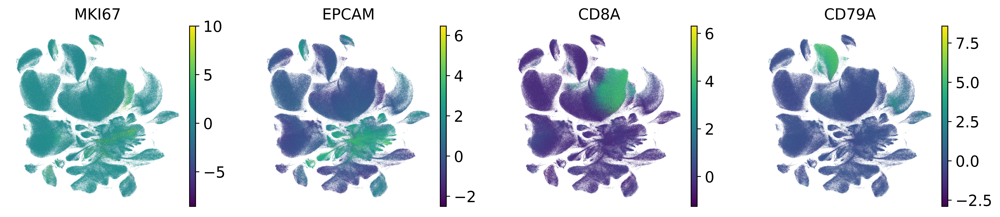

In [13]:
sc.pl.umap(adata,color = ["MKI67","EPCAM","CD8A","CD79A"])

In [ ]:
sc.pl.umap(adata_original,color = ["leiden"])

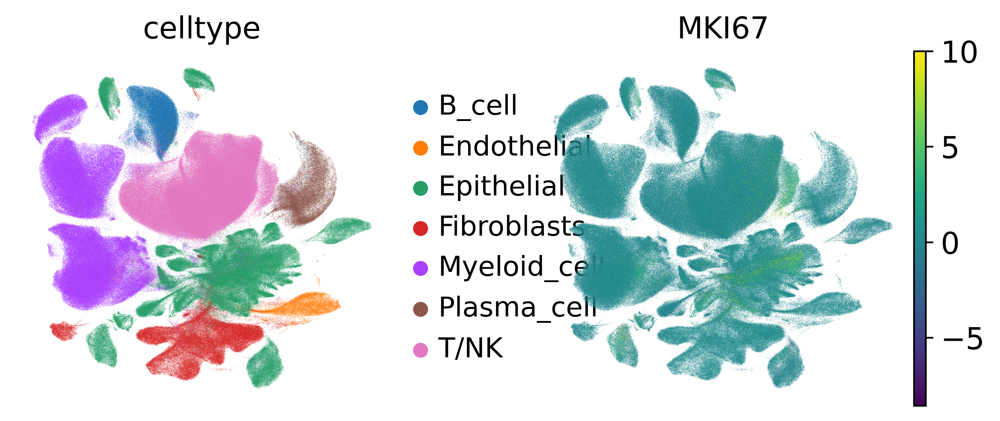

In [139]:
adata_original.obs.loc[adata_original.obs['celltype']=="T_cell/NK",'celltype']  = "T/NK"
adata_original.obs["celltype"] = adata_original.obs["celltype"].cat.remove_categories("T_cell/NK")
sc.pl.umap(adata_original,color = ["celltype","MKI67"])

In [84]:
from matplotlib.backends.backend_pdf import PdfPages
import matplotlib.pyplot as plt
adata_original.obs['leiden'] = adata_original.obs['leiden'].astype("category")
adata_original.obs['leiden'] = [str(icell) for icell in adata_original.obs['leiden']]
with PdfPages('./figures/cluster.pdf') as pdf:  
    for i in range(56):
        adata_original.obs[str(i)] = "NA"
        adata_original.obs.loc[adata_original.obs['leiden']== str(i),str(i)] = "c14"
        fig = sc.pl.umap(adata_original, color=[str(i)],show=False,palette={
            "NA": "grey",
            "c14": "red"
         }).get_figure()
        pdf.savefig(fig)
        plt.close()

In [74]:
from matplotlib.backends.backend_pdf import PdfPages
import matplotlib.pyplot as plt
markers =  ["EPCAM","ENG","PECAM1","RGS5","MYH11","COL1A1","CD79A","IGHG1","ITGAX","NKG7","CPA3","CD14","CD1C","FCN1","FCGR3B"]

with PdfPages('./combined_data/figures/marker.pdf') as pdf:  
    for imarkers in markers:
        adata_original.obs[str(i)] = "NA"
        adata_original.obs.loc[adata_original.obs['leiden']== str(i),str(i)] = "c14"
        fig = sc.pl.umap(adata_original, color=[imarkers],show=False).get_figure()
        pdf.savefig(fig)
        plt.close()

In [77]:
from matplotlib.backends.backend_pdf import PdfPages
import matplotlib.pyplot as plt
markers =  ["LILRA4","CLEC9A","CD1C","LAMP3","FCGR3B"]

with PdfPages('./combined_data/figures/myeloid_marker.pdf') as pdf:  
    for imarkers in markers:
        fig = sc.pl.umap(adata_original, color=[imarkers],show=False).get_figure()
        pdf.savefig(fig)
        plt.close()

In [149]:
sc.pl.umap(adata_original,color = ["leiden",'doublet.score'],legend_loc="on data",legend_fontsize = 5)

In [ ]:
sc.pl.umap(adata_original,color = ["ITGAX","CPA3","FCGR3B","CD1C","CD14","FCN1","LILRA4","CLEC9A","LAMP3","CD14"])

In [ ]:
sc.pl.umap(adata_original,color = ["CD8A","NKG7"])

In [38]:
a = Counter(adata_original.obs.loc[adata_original.obs["leiden"]==str(16),'celltype'])
a.most_common(2)

[('Endothelial', 20824), ('Fibroblasts', 1287)]

In [39]:
cell_number = [] # 每一类排名靠前的两类细胞数目
cell_number_ratio = [] # 每一类手动标注的占所有的细胞数目
for i in range(57):
    cell_number.append(Counter(adata_original.obs.loc[adata_original.obs["leiden"]==str(i),'celltype']).most_common(2))
    cell_number_ratio.append(cell_number[i][0][1]/len(adata_original.obs.loc[adata_original.obs["leiden"]==str(i),'celltype']))
cell_number_ratio = pd.Series(cell_number_ratio)
cell_number_ratio.index = range(57)

In [44]:
cell_type_cluster = [cell_number[i][0][0] for i in range(57)]
cell_type_cluster = pd.Series(cell_type_cluster)
cell_type_cluster

0             T/NK
1     Myeloid_cell
2       Epithelial
3     Myeloid_cell
4             T/NK
5             T/NK
6           B_cell
7             T/NK
8     Myeloid_cell
9      Plasma_cell
10     Fibroblasts
11            T/NK
12    Myeloid_cell
13      Epithelial
14    Myeloid_cell
15     Fibroblasts
16     Endothelial
17     Fibroblasts
18    Myeloid_cell
19      Epithelial
20    Myeloid_cell
21    Myeloid_cell
22      Epithelial
23            T/NK
24      Epithelial
25      Epithelial
26      Epithelial
27      Epithelial
28      Epithelial
29      Epithelial
30      Epithelial
31      Epithelial
32      Epithelial
33      Epithelial
34            T/NK
35     Fibroblasts
36      Epithelial
37      Epithelial
38     Fibroblasts
39      Epithelial
40    Myeloid_cell
41      Epithelial
42          B_cell
43      Epithelial
44          B_cell
45      Epithelial
46      Epithelial
47          B_cell
48     Fibroblasts
49     Plasma_cell
50      Epithelial
51      Epithelial
52     Plasm

In [45]:
celltype_scanpy = [cell_type_cluster[int(i)] for i in adata_original.obs['leiden'] ]

In [311]:
adata_original.obs['celltype_scanpy'] = celltype_scanpy

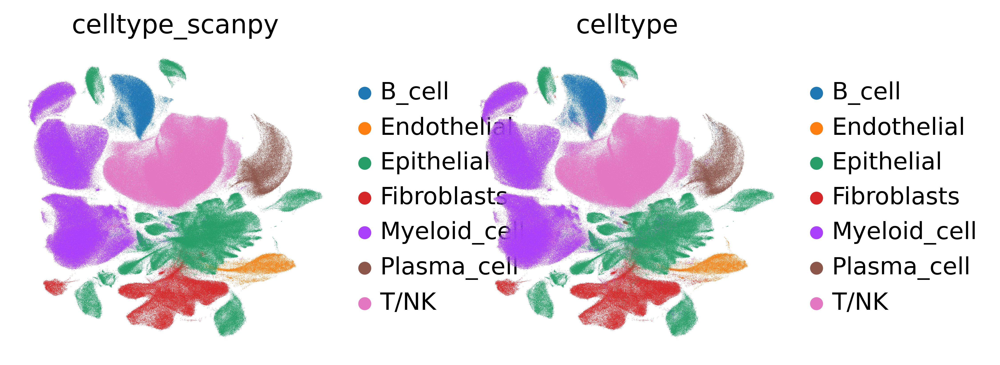

In [314]:
sc.pl.umap(adata_original,color = ["celltype_scanpy",'celltype'])

In [318]:
adata_original.write(results_file)

In [325]:
meta_data_save = adata_original.obs.loc[:,['leiden','celltype',"celltype_scanpy"]]

In [328]:
meta_data_save.to_csv("./combined_data/meta_data0609.csv")

In [306]:
len(adata.obs['leiden'].astype(np.uint32))

1200545

## myeloid_cluster

In [269]:
myeloid_cluster = [12,3,14,20,8,1,21,40,18]
a = adata_original.obs['leiden'].astype(np.uint32)
b = [i for i in range(len(a)) if a[i] in myeloid_cluster]
TP = sum(adata_original.obs.loc[adata_original.obs_names[b],'celltype']=="Myeloid_cell")
celltype_all = len((adata_original.obs.loc[adata_original.obs_names[b],'celltype']=="Myeloid_cell"))
accuracy = TP/celltype_all
accuracy

0.9773278651539548

In [266]:
cell_number_ratio[myeloid_cluster]

12    0.975773
3     0.971814
14    0.996071
20    0.998720
8     0.991862
1     0.994966
21    0.966265
40    0.864936
18    0.879413
dtype: float64

In [267]:
# 召回率
recall = TP/sum(adata_original.obs['celltype']=="Myeloid_cell")
recall

## T_NK_cluster

In [269]:
T_NK = [0,5,34,7,4,11,23]
a = adata_original.obs['leiden'].astype(np.uint32)
b = [i for i in range(len(a)) if a[i] in T_NK]
TP = sum(adata_original.obs.loc[adata_original.obs_names[b],'celltype']=="T/NK")
celltype_all = len((adata_original.obs.loc[adata_original.obs_names[b],'celltype']=="T/NK"))
accuracy = TP/celltype_all
accuracy

0.9773278651539548

In [266]:
cell_number_ratio[T_NK]

12    0.975773
3     0.971814
14    0.996071
20    0.998720
8     0.991862
1     0.994966
21    0.966265
40    0.864936
18    0.879413
dtype: float64

In [267]:
# 召回率
recall = TP/sum(adata_original.obs['celltype']=="T_NK")
recall

## endo_cluster

In [284]:
endo_cluster = [16]
a = adata_original.obs['leiden'].astype(np.uint32)
b = [i for i in range(len(a)) if a[i] in endo_cluster]
TP = sum(adata_original.obs.loc[adata_original.obs_names[b],'celltype']=="Endothelial")
celltype_all = len((adata_original.obs.loc[adata_original.obs_names[b],'celltype']=="Endothelial"))
accuracy = TP/celltype_all
accuracy

0.9254699791120394

In [285]:
# 召回率
recall = TP/sum(adata_original.obs['celltype']=="Endothelial")
recall

0.9699566817271414

In [286]:
cell_number_ratio[endo_cluster]

16    0.92547
dtype: float64

## B

In [ ]:
sc.pl.umap(adata_original,color = ["CD79A","IGHG1"])

In [296]:
Plasma_cell =  [9,49,52,53,56]
a = adata_original.obs['leiden'].astype(np.uint32)
b = [i for i in range(len(a)) if a[i] in Plasma_cell]
TP = sum(adata_original.obs.loc[adata_original.obs_names[b],'celltype']=="Plasma_cell")
celltype_all = len((adata_original.obs.loc[adata_original.obs_names[b],'celltype']=="Plasma_cell"))
accuracy = TP/celltype_all
accuracy

0.958291885746767

In [297]:
# 召回率
recall = TP/sum(adata_original.obs['celltype']=="Plasma_cell")
recall

0.8856517456495567

In [298]:
cell_number_ratio[Plasma_cell]

9     0.95822
49    1.00000
52    1.00000
53    1.00000
56    1.00000
dtype: float64

## EPI

In [12]:
from collections import Counter

In [16]:
adata_original = adata

In [7]:
meta_data = pd.read_csv("./combined_data/meta_data0609.csv",index_col=0)

In [18]:
EPI_cell = np.unique(meta_data.loc[meta_data['celltype_scanpy']=="Epithelial","leiden"])
a = adata_original.obs['leiden'].astype(np.uint32)
b = [i for i in range(len(a)) if a[i] in EPI_cell]
TP = sum(adata_original.obs.loc[adata_original.obs_names[b],'celltype']=="Epithelial")
celltype_all = len((adata_original.obs.loc[adata_original.obs_names[b],'celltype']=="Epithelial"))
accuracy = TP/celltype_all
accuracy

0.9687355860078264

In [20]:
# 召回率
recall = TP/sum(adata_original.obs['celltype']=="Epithelial")
recall

0.9758721474875407

In [37]:
cell_number = [] # 每一类排名靠前的两类细胞数目
cell_number_ratio = [] # 每一类手动标注的占所有的细胞数目
for i in range(len(EPI_cell)):
    cell_number.append(Counter(adata_original.obs.loc[adata_original.obs["leiden"]==str(EPI_cell[i]),'orig.ident']).most_common(2))
    cell_number_ratio.append(cell_number[i][0][1]/len(adata_original.obs.loc[adata_original.obs["leiden"]==str(EPI_cell[i]),'orig.ident']))
cell_number_ratio = pd.Series(cell_number_ratio)
cell_number_ratio.index = EPI_cell

In [39]:
cell_number

[[('GB_001_HG', 7014), ('GBC_006_P', 6042)],
 [('GBC_008_P', 8998), ('GBC_028_OM', 3560)],
 [('GBC_056_P', 10793), ('GBC_056_LN', 8998)],
 [('GBC_007_P', 13747), ('GBC_003_P', 7)],
 [('GBC_086_P', 11733), ('GBC_021_P', 44)],
 [('GBC_034_P', 11613), ('GBC_056_P', 2)],
 [('CC_006', 3722), ('GBC_036_LI', 887)],
 [('GBC_022_P', 6884), ('GBC_065_P', 3135)],
 [('GBC_064_LM', 6134), ('GBC_064_P', 4262)],
 [('GB_002_LG', 4025), ('GBC_047_P', 2049)],
 [('GBC_031_P', 9192), ('GBC_013_P', 61)],
 [('GBC_015_P', 9245), ('GBC_014_P', 1)],
 [('GBC_087_P', 8612), ('GBC_071_P', 3)],
 [('GBC_030_P', 7987), ('GBC_009_P', 4)],
 [('GBC_072_P', 6589), ('GBC_018_P', 7)],
 [('GBC_054_LI', 5320), ('GBC_054_P', 86)],
 [('GBC_012_LI', 3955), ('GBC_012_P', 163)],
 [('GBC_024_LM', 3254), ('GB_002_LG', 279)],
 [('GBC_061_P', 1520), ('GBC_006_P', 989)],
 [('GBC_071_P', 639), ('GBC_020_P', 325)],
 [('GBC_051_P', 1430), ('GBC_032_P', 4)],
 [('GBC_027_P', 20)],
 [('GBC_006_P', 16)],
 [('GBC_043_P', 11)],
 [('GBC_048_P'

In [33]:
cell_number_ratio

2     0.089553
13    0.292409
19    0.543509
22    0.998330
24    0.995926
25    0.999226
26    0.329381
27    0.647236
28    0.588619
29    0.426603
30    0.979644
31    0.999892
32    0.998493
33    0.998001
36    0.993067
37    0.983182
39    0.940771
41    0.847837
43    0.591670
45    0.424303
46    0.990305
50    1.000000
51    1.000000
54    1.000000
55    1.000000
dtype: float64

# split data

In [2]:
adata = sc.read_h5ad("./combined_data/combine_final0609.h5ad")

In [10]:
meta_data = pd.read_csv("./combined_data/meta_data0609.csv",index_col = 0)
meta_data

,leiden,celltype,celltype_scanpy
GBC_051_P_AAACGAAGTAGGCAGT,6,B_cell,B_cell
GBC_051_P_AAACGCTGTGAATTGA,6,B_cell,B_cell
GBC_051_P_AAAGGATGTTAAGACA,6,B_cell,B_cell
GBC_051_P_AAAGGTAAGATCCTAC,6,B_cell,B_cell
GBC_051_P_AACAAAGAGACATCCT,6,B_cell,B_cell
...,...,...,...
XGC_012_TTTGTTGGTCCAAATC,0,T/NK,T/NK
XGC_012_TTTGTTGGTCCACATA,4,T/NK,T/NK
XGC_012_TTTGTTGTCCAGCAAT,11,T/NK,T/NK
XGC_012_TTTGTTGTCTCCACTG,0,T/NK,T/NK


In [12]:
adata = adata[meta_data.index,:]

In [14]:
adata.obs['leiden'] = meta_data['leiden']

/tmp/ipykernel_2189210/2658210039.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['leiden'] = meta_data['leiden']


In [17]:
adata.obs['celltype'] = meta_data['celltype']
adata.obs['celltype_scanpy'] = meta_data['celltype_scanpy']

In [6]:
name = [str(iname).split("-")[0] for iname in adata.obs_names]
adata.obs_names = name

In [8]:
adata.obs.loc[adata.obs['celltype']=="T_cell/NK",'celltype']  = "T/NK"
adata.obs["celltype"] = adata.obs["celltype"].cat.remove_categories("T_cell/NK")

In [ ]:
adata.write("./combined_data/combine_final0609.h5ad")

In [21]:
from sklearn.metrics import confusion_matrix

In [23]:
a = confusion_matrix(adata.obs['celltype_scanpy'], adata.obs['celltype'], labels=None, sample_weight=None)

In [49]:
for itype in celltype:
    celltype_data = adata[adata.obs["celltype_scanpy"]==itype,]
    celltype_data.write("./combined_data/h5ad_file/",itype,".h5ad") 

In [35]:
Counter(meta_data["celltype_scanpy"])

Counter({'B_cell': 66389,
         'Myeloid_cell': 323569,
         'T/NK': 382867,
         'Epithelial': 268836,
         'Plasma_cell': 42222,
         'Fibroblasts': 98012,
         'Endothelial': 22501})

# soupx

In [28]:
import scanpy as sc
import pandas as pd 
import numpy as np
import matplotlib.pyplot as pl
from matplotlib import rcParams
import os
from collections import Counter
os.chdir("/home/wyh/scdata/combined_data_soupx/")

In [29]:
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
#sc.logging.print_versions()
results_file = 'combined_soupx_filter0609.h5ad'
sc.settings.set_figure_params(dpi=300, frameon=False, figsize=(3, 3), facecolor='white') 

In [30]:
adata = sc.read_h5ad("combined_soupx_filter0609.h5ad")

In [31]:
sc.pp.regress_out(adata, ['nCount_RNA', 'nFeature_RNA',"S_score","G2M_score"])

regressing out ['nCount_RNA', 'nFeature_RNA', 'S_score', 'G2M_score']
    sparse input is densified and may lead to high memory use
    finished (1:12:43)


In [32]:
sc.pp.scale(adata, max_value=10)

In [33]:
sc.tl.pca(adata, svd_solver='arpack')
#sc.pl.pca(adata, color='CST3')
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=30)
sc.tl.umap(adata)
sc.tl.leiden(adata)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:06:58)
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:29)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:18:46)
running Leiden clustering
    finished: found 50 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:28:19)


In [34]:
results_file = "/home/wyh/scdata/combined_data_soupx/combined_data_soupx0609.h5ad"
adata.write(results_file)

In [36]:
adata = sc.read_h5ad(results_file)

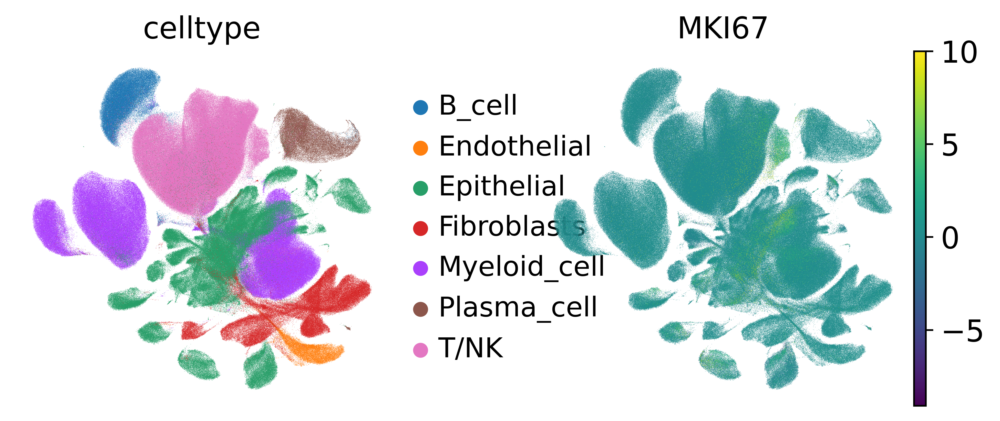

In [140]:
adata.obs.loc[adata.obs['celltype']=="T_cell/NK",'celltype']  = "T/NK"
adata.obs["celltype"] = adata.obs["celltype"].cat.remove_categories(['T_cell/NK'])
sc.pl.umap(adata,color = ["celltype","MKI67"])

In [143]:
adata

AnnData object with n_obs × n_vars = 1200545 × 2960
    obs: 'B.cells.corr', 'Cell.Type', 'CellCycle.score', 'Endothelial.corr', 'Epithelial.corr', 'Fibroblast.corr', 'GS__ADIPOGENESIS', 'GS__ALLOGRAFT_REJECTION', 'GS__ANDROGEN_RESPONSE', 'GS__ANGIOGENESIS', 'GS__APICAL_JUNCTION', 'GS__APICAL_SURFACE', 'GS__APOPTOSIS', 'GS__BILE_ACID_METABOLISM', 'GS__CHOLESTEROL_HOMEOSTASIS', 'GS__COAGULATION', 'GS__COMPLEMENT', 'GS__DNA_REPAIR', 'GS__E2F_TARGETS', 'GS__EPITHELIAL_MESENCHYMAL_TRANSITION', 'GS__ESTROGEN_RESPONSE_EARLY', 'GS__ESTROGEN_RESPONSE_LATE', 'GS__FATTY_ACID_METABOLISM', 'GS__G2M_CHECKPOINT', 'GS__GLYCOLYSIS', 'GS__HEDGEHOG_SIGNALING', 'GS__HEME_METABOLISM', 'GS__HYPOXIA', 'GS__IL2_STAT5_SIGNALING', 'GS__IL6_JAK_STAT3_SIGNALING', 'GS__INFLAMMATORY_RESPONSE', 'GS__INTERFERON_ALPHA_RESPONSE', 'GS__INTERFERON_GAMMA_RESPONSE', 'GS__KRAS_SIGNALING_DN', 'GS__KRAS_SIGNALING_UP', 'GS__MITOTIC_SPINDLE', 'GS__MTORC1_SIGNALING', 'GS__MYC_TARGETS_V1', 'GS__MYC_TARGETS_V2', 'GS__MYOGENESIS',

In [63]:
adata.obs["celltype"].cat.remove_categories('T_cell/NK')
adata.obs["celltype"]

CC_004_ACACCAACAAATGAAC            B_cell
CC_004_ATTATCCGTTGCGGAA            B_cell
CC_004_CACGTGGCAAATGCTC            B_cell
CC_004_CCCGGAAGTATCGAAA            B_cell
CC_004_TATACCTGTTGAGTCT            B_cell
                                 ...     
GBC_087_P_TTTGACTTCATGCAGT    Fibroblasts
GBC_087_P_TTTGGAGTCTAGCAAC    Fibroblasts
GBC_087_P_TTTGTTGAGTCACAGG    Fibroblasts
GBC_087_P_TTTGTTGCAAGTGTCT    Fibroblasts
GBC_087_P_TTTGTTGCACAGCTTA    Fibroblasts
Name: celltype, Length: 1200545, dtype: category
Categories (8, object): ['B_cell', 'Endothelial', 'Epithelial', 'Fibroblasts', 'Myeloid_cell', 'Plasma_cell', 'T/NK', 'T_cell/NK']

In [43]:
adata.obs['celltype']

CC_004_ACACCAACAAATGAAC            B_cell
CC_004_ATTATCCGTTGCGGAA            B_cell
CC_004_CACGTGGCAAATGCTC            B_cell
CC_004_CCCGGAAGTATCGAAA            B_cell
CC_004_TATACCTGTTGAGTCT            B_cell
                                 ...     
GBC_087_P_TTTGACTTCATGCAGT    Fibroblasts
GBC_087_P_TTTGGAGTCTAGCAAC    Fibroblasts
GBC_087_P_TTTGTTGAGTCACAGG    Fibroblasts
GBC_087_P_TTTGTTGCAAGTGTCT    Fibroblasts
GBC_087_P_TTTGTTGCACAGCTTA    Fibroblasts
Name: celltype, Length: 1200545, dtype: category
Categories (5, object): ['B_cell', 'Endothelial', 'Fibroblasts', 'Plasma_cell', 'nan']

In [49]:
meta_data = pd.read_csv("./meta_data.csv",index_col = 0)

/tmp/ipykernel_286406/2428896735.py:1: DtypeWarning: Columns (74) have mixed types. Specify dtype option on import or set low_memory=False.
  meta_data = pd.read_csv("./meta_data.csv",index_col = 0)


In [51]:
adata.obs['celltype'] = meta_data.loc[adata.obs_names,"celltype"]

In [85]:
a = 
a = max(adata.obs['leiden'].astype(np.uint32))
max(a)

49

In [86]:
from matplotlib.backends.backend_pdf import PdfPages
import matplotlib.pyplot as plt

with PdfPages('./combined_data_soupx/figures/cluster.pdf') as pdf:  
    for i in range(max(adata.obs['leiden'].astype(np.uint32))):
        adata.obs[str(i)] = "NA"
        adata.obs.loc[adata.obs['leiden']== str(i),str(i)] = "c14"
        fig = sc.pl.umap(adata, color=[str(i)],show=False,palette={
            "NA": "grey",
            "c14": "red"
         }).get_figure()
        pdf.savefig(fig)
        plt.close()

In [70]:
from matplotlib.backends.backend_pdf import PdfPages
import matplotlib.pyplot as plt
markers =  ["EPCAM","ENG","PECAM1","RGS5","MYH11","COL1A1","CD79A","IGHG1","ITGAX","NKG7","CPA3","CD14","CD1C","FCN1","FCGR3B"]

with PdfPages('./figures/marker.pdf') as pdf:  
    for imarkers in markers:
        adata.obs[str(i)] = "NA"
        adata.obs.loc[adata.obs['leiden']== str(i),str(i)] = "c14"
        fig = sc.pl.umap(adata, color=[imarkers],show=False).get_figure()
        pdf.savefig(fig)
        plt.close()

In [80]:
from matplotlib.backends.backend_pdf import PdfPages
import matplotlib.pyplot as plt
markers =  ["CD1C","LAMP3","FCGR3B"]

with PdfPages('./combined_data_soupx//figures/myeloid_marker.pdf') as pdf:  
    for imarkers in markers:
        adata.obs[str(i)] = "NA"
        adata.obs.loc[adata.obs['leiden']== str(i),str(i)] = "c14"
        fig = sc.pl.umap(adata, color=[imarkers],show=False).get_figure()
        pdf.savefig(fig)
        plt.close()

## something else

In [ ]:
from matplotlib import cm, colors
vega_20 = list(map(colors.to_hex, cm.tab20.colors))
vega_20_scanpy = [
    # dark without grey:
    *vega_20[0:14:2],
    *vega_20[16::2],
    # light without grey:
    *vega_20[1:15:2],
    *vega_20[17::2],
    # manual additions:
    '#ad494a',
    '#8c6d31',
]


In [ ]:
pd.DataFrame(vega_20_scanpy).to_csv("/home/wyh/scdata/combined_data/figures/color.csv")